In [1]:
%cd /scratch/imb/uqjxie6/benchmmarking/DeepHis2Exp/results/pf_cv

/scratch/imb/uqjxie6/benchmmarking/DeepHis2Exp/results/pf_cv


In [2]:
import warnings
warnings.filterwarnings('ignore')
import squidpy as sq
import argparse
import configparser
from pathlib import Path
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import seaborn as sns
from anndata import read_h5ad
from scipy import stats
import seaborn as sns
from matplotlib_venn import venn3
import pickle

In [3]:
samps_all = ["VLP78_A","VLP79_A","VLP79_D","VLP80_A","VLP80_D","VLP81_A","VLP82_A","VLP82_D","VLP83_A","VLP83_D"]

In [7]:
def load_dfs(samps, method):
    df_pc = pd.DataFrame()
    df_sc = pd.DataFrame()
    dfs = {}

    for sample in samps:    
        if method == "stimage":
            df = pd.read_csv(f"stimage_cor_{sample}_pretrained.csv")
            df_pc[sample] = df["Pearson correlation"]
            df_sc[sample] =df["Spearman correlation"]
       
        elif method == "stnet":
            df = pd.read_csv(f"stnet_cor_{sample}.csv")
            df_pc[sample] = df["Pearson correlation"]
            df_sc[sample] =df["Spearman correlation"]

        elif method == "hist2st":
            df = pd.read_csv(f"./hist2st_cor_{sample}.csv") # OLD
            df_pc[sample] = df["Pearson correlation"]
            df_sc[sample] =df["Spearman correlation"]

        elif method == "histogene":
            df = pd.read_csv(f"./histogene_cor_{sample}.csv") # OLD
            df_pc[sample] = df["Pearson correlation"]
            df_sc[sample] =df["Spearman correlation"]

        elif method == "deepspace":
            df = pd.read_csv(f"./deepspace4/{sample}/corR_teacher.txt", sep='\t')
            df_pc[sample] = df['corR']
            df_sc[sample] =df['corS']

        dfs[sample] = df
        
    return df_pc, df_sc, dfs


In [8]:
dfp_stimage, dfs_stimage, dfa_stimage = load_dfs(samps_all, "stimage")
dfp_hist2st, dfs_hist2st, dfa_hist2st = load_dfs(samps_all, "hist2st")
dfp_deepsp, dfs_deepsp, dfa_deepsp = load_dfs(samps_all, "deepspace")
dfp_histog, dfs_histog, dfa_histog = load_dfs(samps_all, "histogene")
dfp_stnet, dfs_stnet, dfa_stnet = load_dfs(samps_all, "stnet")

# Performance boxplots

In [10]:
def boxplot_individual(df_list, method_id):    
    dfs = [df.assign(Method=method_id[i]) for i,df in enumerate(df_list)]
    cdf = pd.concat(dfs) 
    mdf = pd.melt(cdf, id_vars=['Method'], var_name=['Number'])
    ax = sns.boxplot(x="Number", y="value", hue="Method", data=mdf,showfliers=False)   
    sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
    return ax

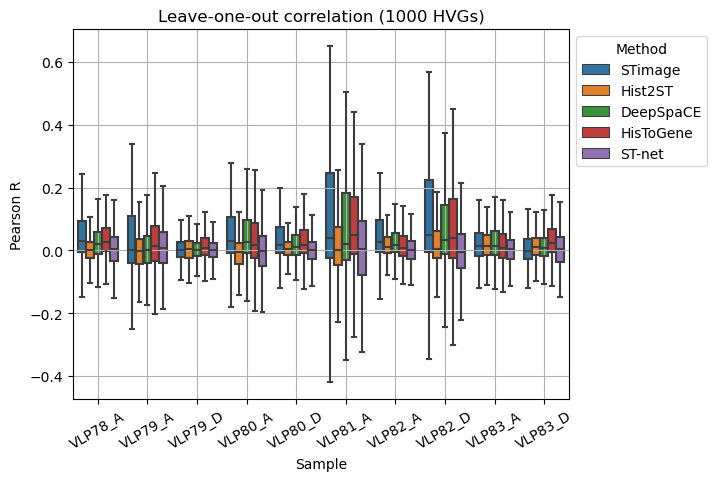

In [13]:
ax = boxplot_individual([dfp_stimage, dfp_hist2st, dfp_deepsp, dfp_histog, dfp_stnet],
                        ["STimage", "Hist2ST", "DeepSpaCE", "HisToGene", "ST-net"])
plt.xlabel("Sample")
plt.ylabel("Pearson R")
plt.title("Leave-one-out correlation (1000 HVGs)")
plt.grid()
plt.setp(ax.get_xticklabels(), rotation=30, horizontalalignment='center')
# plt.savefig(f"{','.join(samps)}-PC-2boxplot-1000.png", bbox_inches='tight')
plt.show()


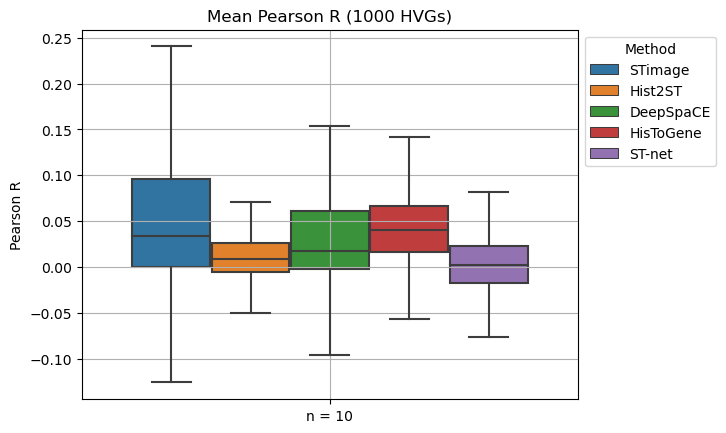

In [11]:
ax = boxplot_individual([df.mean(axis=1).to_frame() for df in [dfp_stimage, dfp_hist2st, dfp_deepsp, dfp_histog, dfp_stnet]], 
                        ["STimage", "Hist2ST", "DeepSpaCE", "HisToGene", "ST-net"])
plt.xlabel("")
plt.ylabel("Pearson R")
plt.title("Mean Pearson R (1000 HVGs)")
plt.grid()
plt.xticks([0], ['n = 10'])
# plt.savefig(f"{','.join(samps)}-PC-2boxplot-1000.png", bbox_inches='tight')
plt.show()

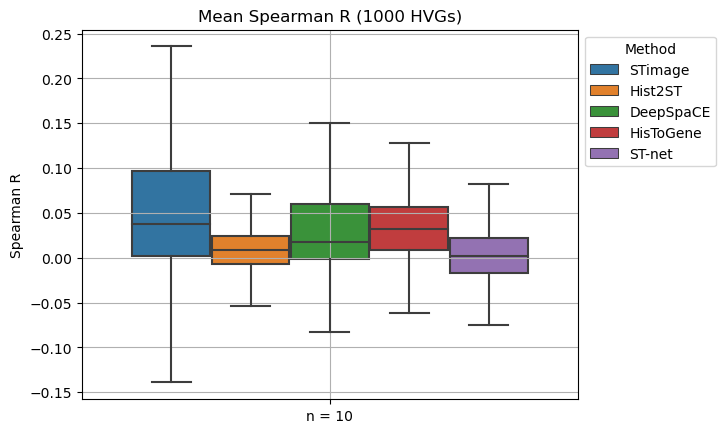

In [12]:
ax = boxplot_individual([df.mean(axis=1).to_frame() for df in [dfs_stimage, dfs_hist2st, dfs_deepsp, dfs_histog, dfs_stnet]],
                        ["STimage", "Hist2ST", "DeepSpaCE", "HisToGene", "ST-net"])
plt.xlabel("")
plt.ylabel("Spearman R")
plt.title("Mean Spearman R (1000 HVGs)")
plt.grid()
plt.xticks([0], ['n = 10'])
# plt.savefig(f"{','.join(samps)}-PC-2boxplot-1000.png", bbox_inches='tight')
plt.show()

# Find top predicted genes

In [184]:
def top_n_genes(df, n):
    return df.sort_values(by=['Pearson correlation'], ascending=False)

def top_pos_cor_genes(df,n, cutoff=0):
    return top_n_genes(df.loc[df['Pearson correlation'] >= cutoff], n)

def top_n_genes_all(dfs, n):
    top_genes = {k:list(top_pos_cor_genes(df,n)['Gene'][:n]) for k,df in dfs.items()}
    return list(set.intersection(*[set(top_genes[key]) for key in top_genes]))


In [185]:
dfa_stimage_all = pd.concat(dfa_stimage.values())
dfavg = dfa_stimage_all.groupby('Gene')['Pearson correlation'].mean().reset_index()

In [208]:
top_avg = top_pos_cor_genes(dfavg,1000, cutoff=0.05)
print("Top genes by average correlation")
top_avg.head(10)


Top genes by average correlation


,Gene,Pearson correlation
373,GPRC5A,0.310199
523,LTB,0.304555
308,FCMR,0.283347
565,MS4A1,0.275254
744,RIPOR2,0.273814
927,TRBC2,0.269977
244,CYTIP,0.267244
508,LIMD2,0.266183
873,TBC1D10C,0.264022
132,CD52,0.263535


In [211]:
top_shared = top_n_genes_all(dfa_stimage,500)
print("Top genes by correlation shared across all samples") 
print(top_shared, f"n={len(top_shared)}")

top_avg[top_avg['Gene'].isin(top_shared)]

Top genes by correlation shared across all samples
['CXCR5', 'TBCD', 'CPSF7', 'CNR2', 'NUP107', 'BPIFB1', 'VDAC3', 'FRS2', 'GPRC5A', 'FGFR3'] n=10


,Gene,Pearson correlation
373,GPRC5A,0.310199
321,FGFR3,0.207572
335,FRS2,0.194014
236,CXCR5,0.184993
182,CNR2,0.157743
74,BPIFB1,0.140215
874,TBCD,0.139512
956,VDAC3,0.123506
617,NUP107,0.106488
205,CPSF7,0.100423


In [207]:
fname = "stimage_top_genes.pkl"
with open(fname, 'wb') as file:  # Overwrites any existing file.
    pickle.dump([top_shared, top_avg], file)

with open('stimage_top_genes.pkl', 'rb') as file:
    top_shared, top_avg = pickle.load(file)

In [203]:
def format_corr(dfs, gene,library_id):
    # Get the correlation from results dfs
    df = dfs[library_id]
    return np.round(list(df[df['Gene']==gene]['Pearson correlation'])[0],2)

def save_plots(genes, library_id, dirr, dfs):
    with open(f"./stimage_preds_{library_id}_pretrained.pkl", "rb") as input_file:
        pred_adata,test_dataset = pickle.load(input_file)
    pred_adata.obsm['spatial'] = pred_adata.obsm['spatial'].astype(np.int64)
    test_dataset.obsm['spatial'] = test_dataset.obsm['spatial'].astype(np.int64)
    
    for gene in genes:
        if gene in pred_adata.var_names and gene in test_dataset.var_names:
            fig, axs = plt.subplots(1, 2, figsize=(20, 12))
            sq.pl.spatial_scatter(pred_adata, library_id=library_id, color=gene, title=f"{gene} - predicted (r={format_corr(dfs, gene, library_id)})", fig=fig, ax=axs[0])
            sq.pl.spatial_scatter(test_dataset, library_id=library_id, color=gene, title=f"{gene} ground truth", fig=fig, ax=axs[1])
            plt.savefig(f"{dirr}/{library_id}-{gene}.png")
        else:
            print(f"{gene} not predicted")

In [205]:
%mkdir stimage_top_plots

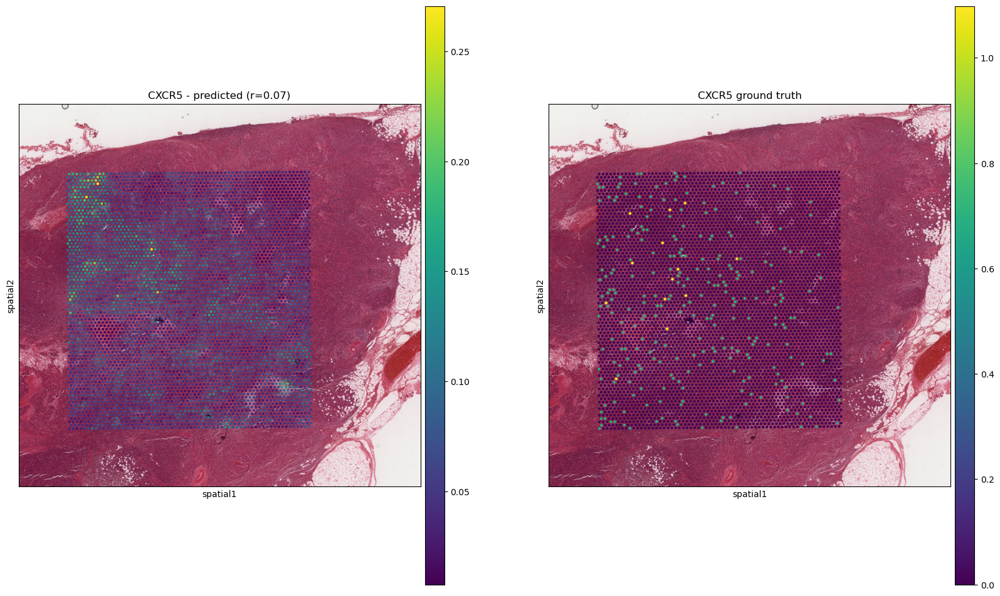

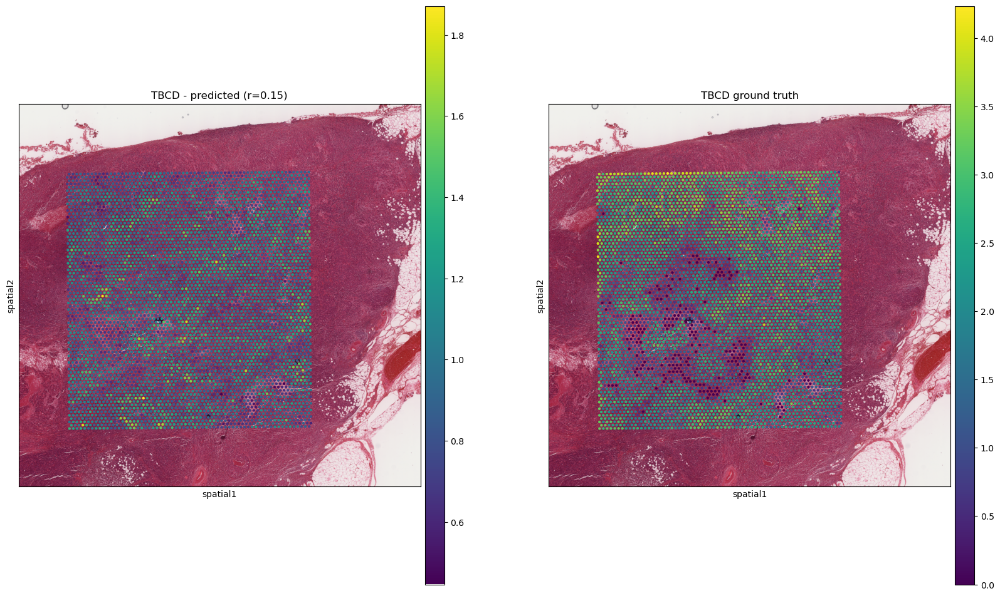

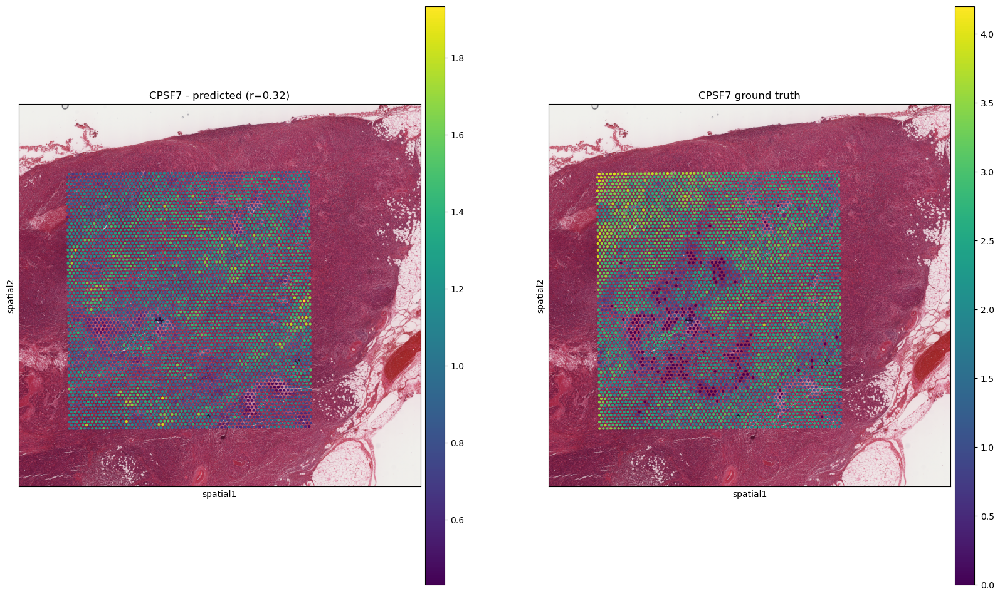

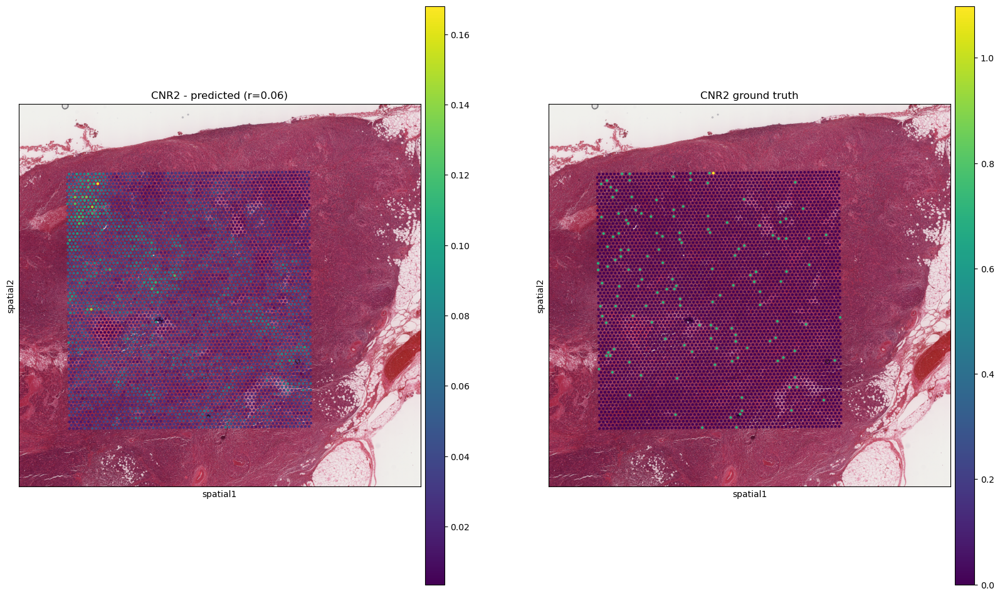

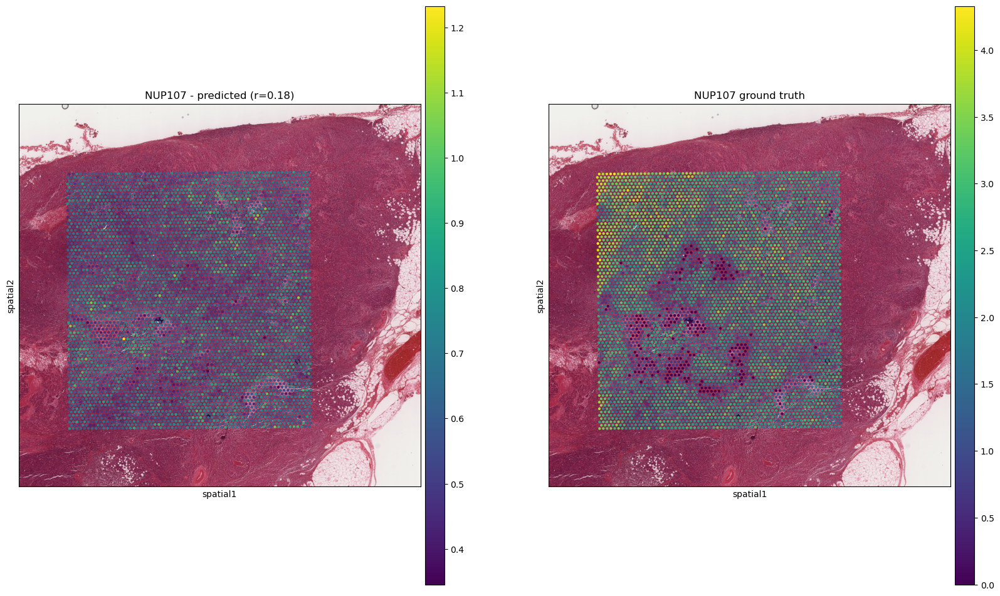

...

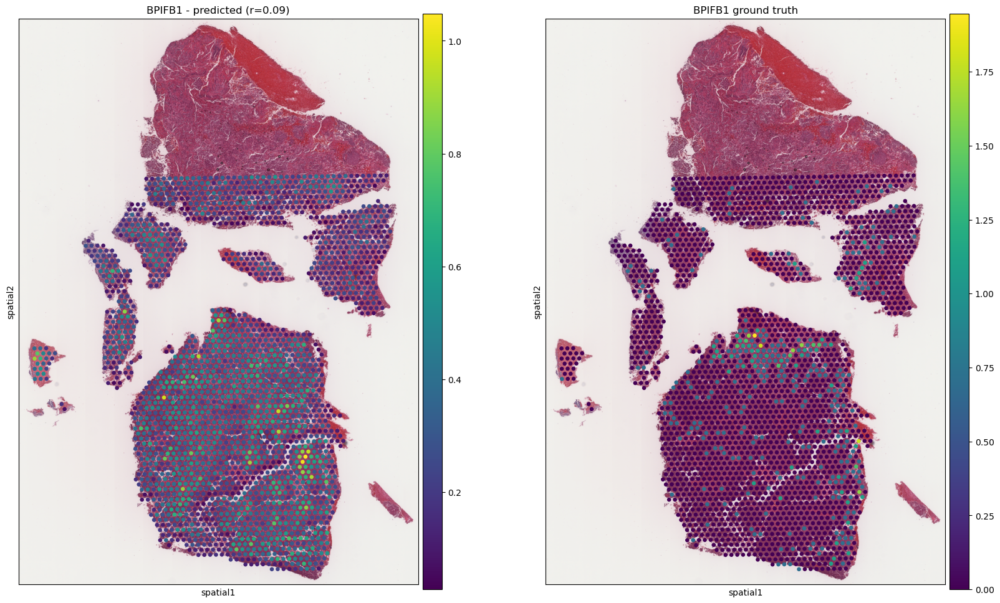

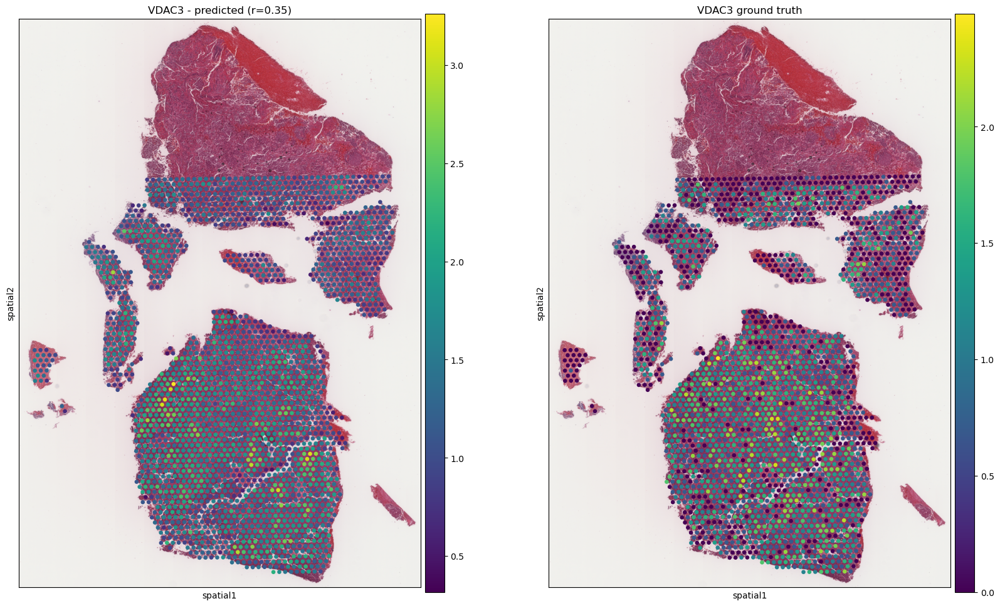

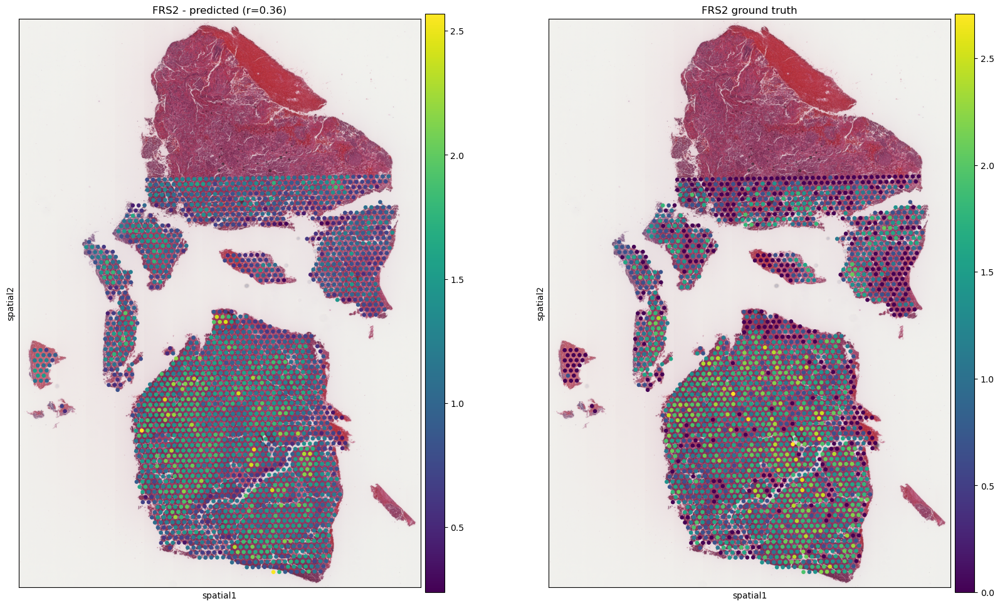

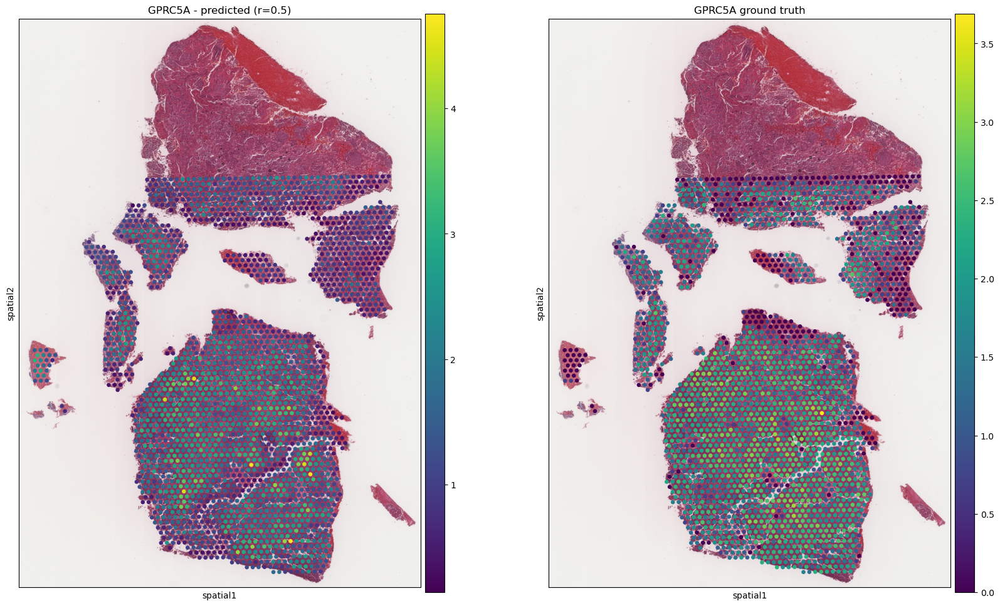

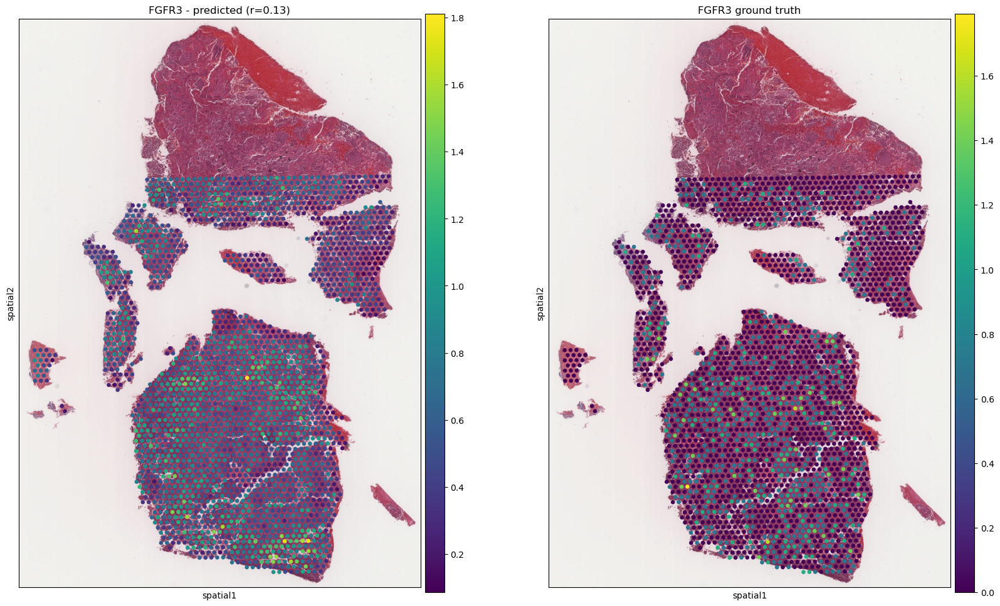

In [206]:
# Spatial plot shared top genes

for samp in samps_all[:2]:
    save_plots(top_shared, samp, "stimage_top_plots", dfa_stimage)